<a href="https://colab.research.google.com/github/Code-Author/ComicFace_Transformer/blob/main/ComicFace_Transformer_Demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import os
import glob
import pathlib
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as T
import torch.nn.functional as F
from torchvision import transforms
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path
from google.colab import drive
import warnings

In [2]:
DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

In [3]:
# Mount Google Drive
drive.mount('/content/drive')

Mounted at /content/drive


In [4]:
# Paths configuration
test_images_path = "/content/drive/MyDrive/All_Brandon_Artwork/TestFacesThatAreBeingWorkedOn"
test_images_dir = pathlib.Path(test_images_path)
all_test_image_paths = sorted(glob.glob(str(test_images_dir/'*')))

In [5]:
# Model paths
Old_Face2Paint_Gen_Path = "/content/drive/MyDrive/All_Deep_Learning_Models/CNN_Models/Face2Paint_Gan_Models/Gen_face2paint_Models_2_Day_3.pth.tar"
Face2Paint_Gen_Path = "/content/drive/MyDrive/All_Deep_Learning_Models/CNN_Models/Original_Face2Paint_Models/Gen_Original_Face2Paint_Models_2.pth.tar"
Latest_Face2Paint_Gen_Path = "/content/drive/MyDrive/All_Deep_Learning_Models/CNN_Models/FineTuned_AnimeGan_GeneratorVer3.pth.tar"
ComicBookStyle_Gen_Path = "/content/drive/MyDrive/All_Deep_Learning_Models/CNN_Models/Gen_FreezeDiscriminator_1024_stronger_Models_52.pth.tar"
ComicBookStyle_Gen_Path2 = "/content/drive/MyDrive/All_Deep_Learning_Models/CNN_Models/Gen_FreezeDiscriminator_1024_stronger_Models_2_55.pth.tar"

In [6]:
LEARNING_RATE = 2e-4

In [7]:
class ConvNormLReLU(nn.Sequential):
    def __init__(self, in_ch, out_ch, kernel_size=3, stride=1, padding=1, pad_mode="reflect", groups=1, bias=False):

        pad_layer = {
            "zero":    nn.ZeroPad2d,
            "same":    nn.ReplicationPad2d,
            "reflect": nn.ReflectionPad2d,
        }
        if pad_mode not in pad_layer:
            raise NotImplementedError

        super(ConvNormLReLU, self).__init__(
            pad_layer[pad_mode](padding),
            nn.Conv2d(in_ch, out_ch, kernel_size=kernel_size, stride=stride, padding=0, groups=groups, bias=bias),
            nn.GroupNorm(num_groups=1, num_channels=out_ch, affine=True),
            nn.LeakyReLU(0.2, inplace=True)
        )


class InvertedResBlock(nn.Module):
    def __init__(self, in_ch, out_ch, expansion_ratio=2):
        super(InvertedResBlock, self).__init__()

        self.use_res_connect = in_ch == out_ch
        bottleneck = int(round(in_ch*expansion_ratio))
        layers = []
        if expansion_ratio != 1:
            layers.append(ConvNormLReLU(in_ch, bottleneck, kernel_size=1, padding=0))

        # dw
        layers.append(ConvNormLReLU(bottleneck, bottleneck, groups=bottleneck, bias=True))
        # pw
        layers.append(nn.Conv2d(bottleneck, out_ch, kernel_size=1, padding=0, bias=False))
        layers.append(nn.GroupNorm(num_groups=1, num_channels=out_ch, affine=True))

        self.layers = nn.Sequential(*layers)

    def forward(self, input):
        out = self.layers(input)
        if self.use_res_connect:
            out = input + out
        return out


class Generator(nn.Module):
    def __init__(self, ):
        super().__init__()

        self.block_a = nn.Sequential(
            ConvNormLReLU(3,  32, kernel_size=7, padding=3),
            ConvNormLReLU(32, 64, stride=2, padding=(0,1,0,1)),
            ConvNormLReLU(64, 64)
        )

        self.block_b = nn.Sequential(
            ConvNormLReLU(64,  128, stride=2, padding=(0,1,0,1)),
            ConvNormLReLU(128, 128)
        )

        self.block_c = nn.Sequential(
            ConvNormLReLU(128, 128),
            InvertedResBlock(128, 256, 2),
            InvertedResBlock(256, 256, 2),
            InvertedResBlock(256, 256, 2),
            InvertedResBlock(256, 256, 2),
            ConvNormLReLU(256, 128),
        )

        self.block_d = nn.Sequential(
            ConvNormLReLU(128, 128),
            ConvNormLReLU(128, 128)
        )

        self.block_e = nn.Sequential(
            ConvNormLReLU(128, 64),
            ConvNormLReLU(64,  64),
            ConvNormLReLU(64,  32, kernel_size=7, padding=3)
        )

        self.out_layer = nn.Sequential(
            nn.Conv2d(32, 3, kernel_size=1, stride=1, padding=0, bias=False),
            nn.Tanh()
        )

    def forward(self, input, align_corners=True):
        out = self.block_a(input)
        half_size = out.size()[-2:]
        out = self.block_b(out)
        out = self.block_c(out)

        if align_corners:
            out = F.interpolate(out, half_size, mode="bilinear", align_corners=True)
        else:
            out = F.interpolate(out, scale_factor=2, mode="bilinear", align_corners=False)
        out = self.block_d(out)

        if align_corners:
            out = F.interpolate(out, input.size()[-2:], mode="bilinear", align_corners=True)
        else:
            out = F.interpolate(out, scale_factor=2, mode="bilinear", align_corners=False)
        out = self.block_e(out)

        out = self.out_layer(out)
        return out


In [8]:
def remove_module_prefix(state_dict):
    return {k.replace('module.', ''): v for k, v in state_dict.items()}

def create_and_load_model(model_path, model_class):
    model = model_class().to(DEVICE)
    optimizer = optim.Adam(model.parameters(), lr=LEARNING_RATE, betas=(0.5, 0.999))

    checkpoint = torch.load(model_path)
    checkpoint['state_dict'] = remove_module_prefix(checkpoint['state_dict'])
    model.load_state_dict(checkpoint['state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer'])

    model = setup_gpus_for_training(model)
    model.eval()
    return model, optimizer

def setup_gpus_for_training(model):
    num_gpus = torch.cuda.device_count()
    if num_gpus > 1:
        print(f"{num_gpus} GPUs available. Using all available GPUs for training.")
        model = nn.DataParallel(model)
    elif num_gpus == 1:
        print("1 GPU available. Using this for training.")
    else:
        print("No GPU available. Training will be performed on CPU.")
    return model

In [9]:
# Load models
face2paint_gen_model, Face2Paint_optimizer = create_and_load_model(Face2Paint_Gen_Path, Generator)
freeze_discriminator_gen_model, freezediscriminator_optimizer = create_and_load_model(ComicBookStyle_Gen_Path, Generator)
fine_tune_face2paint_gen_model, fine_tune_Face2Paint_optimizer = create_and_load_model(Latest_Face2Paint_Gen_Path, Generator)

1 GPU available. Using this for training.
1 GPU available. Using this for training.
1 GPU available. Using this for training.


In [10]:
def process_and_transform_image(image_path, transform):
    image = Image.open(image_path).convert("RGB")
    return transform(image)

def display_drawing_and_face(*images, titles, file_path):
    fig, axs = plt.subplots(1, len(images), figsize=(20, 5))
    for i, image in enumerate(images):
        axs[i].imshow(image if isinstance(image, Image.Image) else image.squeeze(0).cpu().detach().numpy().transpose(1, 2, 0))
        axs[i].set_title(titles[i] + Path(file_path).stem)
    plt.show()


In [11]:
def run_demo(image_path):
    with warnings.catch_warnings():
        warnings.simplefilter("ignore")
        original_image = Image.open(image_path).convert("RGB")

        transform = T.Compose([T.Resize((1024, 1024)), transforms.ToTensor()])
        image_tensor = process_and_transform_image(image_path, transform).to(DEVICE).unsqueeze(0)

        face2paint_image = face2paint_gen_model(image_tensor)
        fine_tune_face2paint_image = fine_tune_face2paint_gen_model(image_tensor)
        freeze_discriminator_image = freeze_discriminator_gen_model(image_tensor)

        display_drawing_and_face(original_image, face2paint_image , fine_tune_face2paint_image, freeze_discriminator_image, image_path)

In [12]:
def display_drawing_and_face(original_image, bryand_lee_image, old_face2Paint_image, Latest_face2Paint_image, file_path):
    # Check if images are tensors and on cuda device
    images = [bryand_lee_image, old_face2Paint_image, Latest_face2Paint_image]
    for i in range(len(images)):
        if torch.is_tensor(images[i]) and images[i].is_cuda:
            images[i] = images[i].cpu().detach().numpy()
            images[i] = np.squeeze(images[i])  # Remove batch dimension
            images[i] = np.transpose(images[i], (1,2,0))  # Transpose (C,H,W) to (H,W,C)

    # Create subplots
    fig, axs = plt.subplots(1, 4, figsize=(20, 5))

    # Display original image
    axs[0].imshow(original_image)
    axs[0].set_title("Original Image: " + Path(file_path).stem)

    image_titles = ["Face2Paint:", " Fine_Tune Face2Paint: ", "Freeze Discriminator:"]
    # Display other images
    for i in range(3):
        axs[i+1].imshow(images[i])
        axs[i+1].set_title(image_titles[i] + Path(file_path).stem)

    # Show the plot
    plt.show()

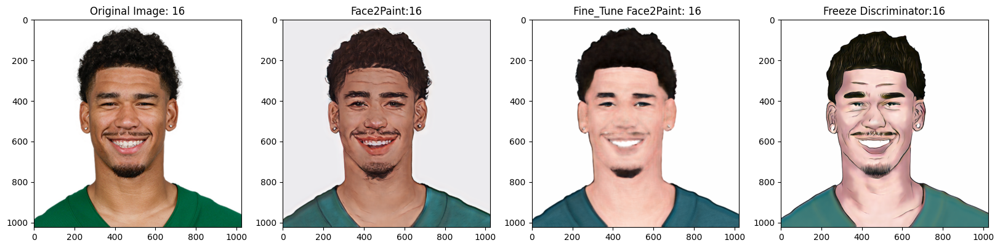

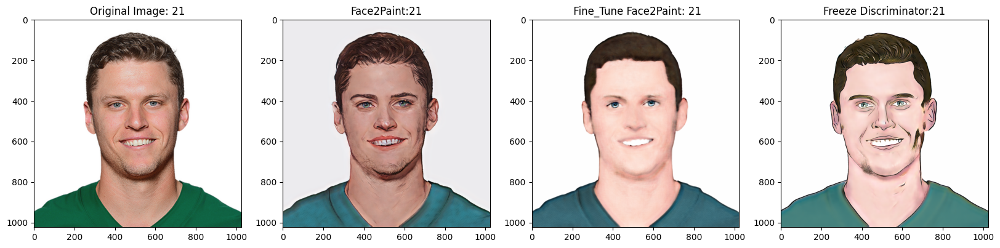

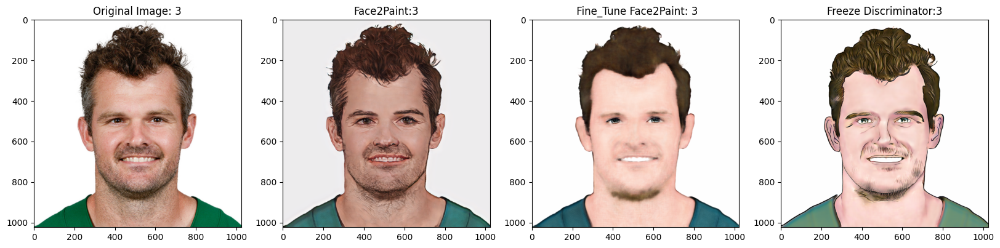

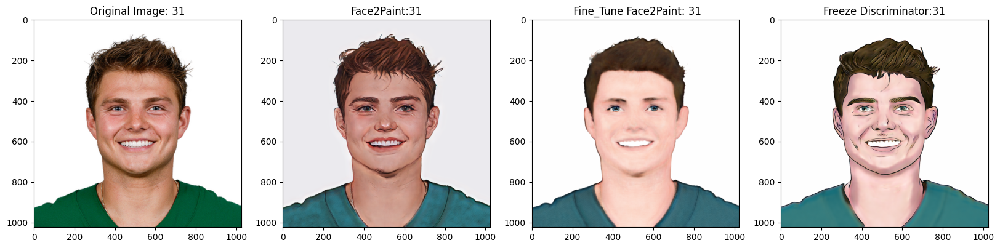

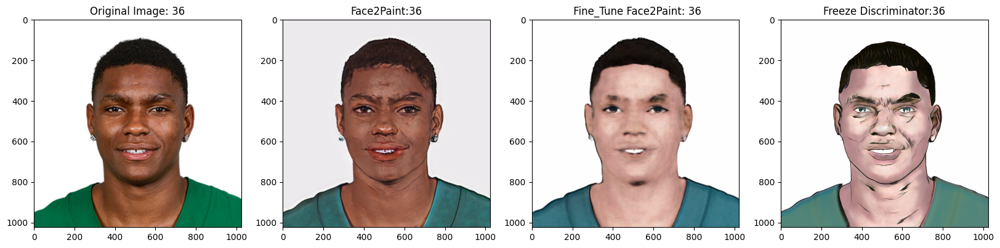

...

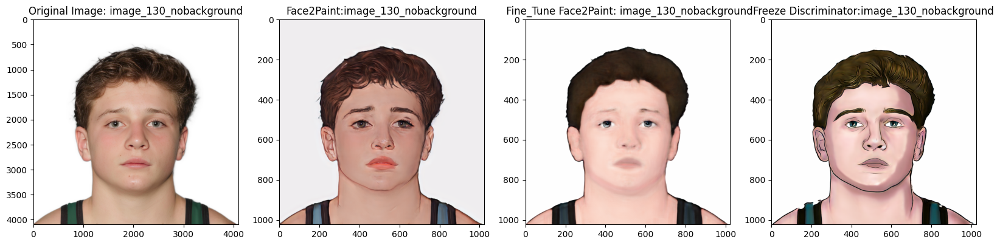

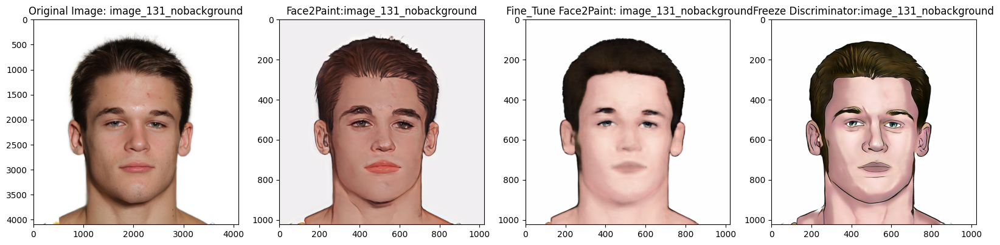

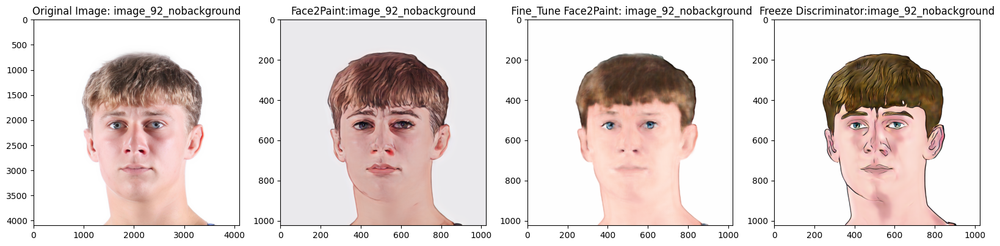

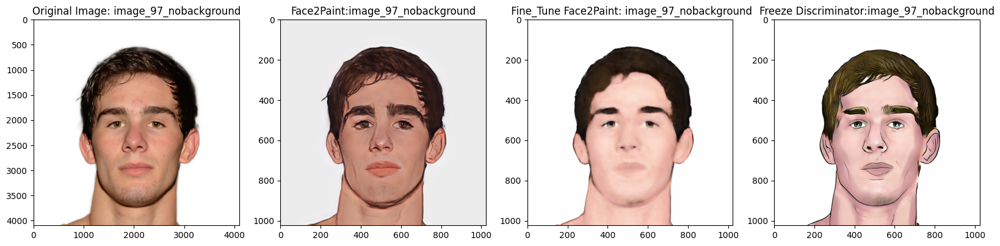

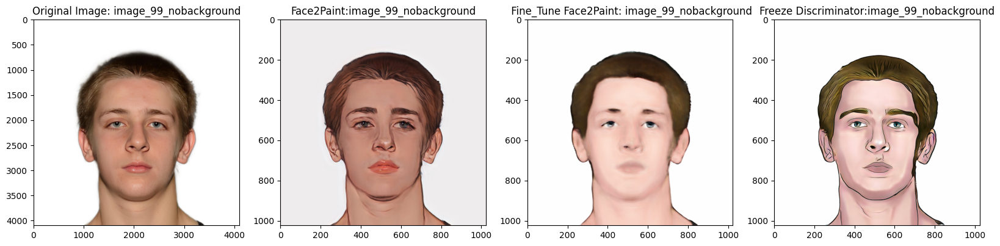

In [13]:
for image_path in all_test_image_paths:
  run_demo(image_path)